In [3]:
import anndata
import pixelator
import torch
import scvi
import scipy
# from scvi import autotune

import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from tqdm import tqdm

from scib_metrics.benchmark import Benchmarker, BioConservation, BatchCorrection

# import ray
# from ray import tune


from PixelGen.pxl_utils import *
from PixelGen.scvi_utils import plot_losses
from PixelGen.tests import test_convert_edgelist_to_protein_pair_colocalization

from pixelator.plot import molecule_rank_plot, cell_count_plot, scatter_umi_per_upia_vs_tau
from pixelator.statistics import clr_transformation
from pixelator.analysis.normalization import dsb_normalize

from scipy.sparse.csgraph import dijkstra
import hotspot

import tempfile

from scvi import REGISTRY_KEYS
from scvi.module.base import (
    BaseModuleClass,
    LossOutput,
    PyroBaseModuleClass,
    auto_move_data,
)
from torch.distributions import NegativeBinomial, Normal, Poisson
from torch.distributions import kl_divergence as kl

from PixelGen.modules import MultiModalSCVI

print(torch.cuda.is_available())

%load_ext autoreload
%autoreload 2

scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"

True


Seed set to 0


Last run with scvi-tools version: 1.2.2.post2


In [4]:
DATA_DIR = Path('./PixelGen/datasets/technote-cart-fmc63-v2.0')


FILENAMES = [
    "Sample01_human_pbmcs_control.layout.dataset.pxl",
    "Sample02_Raji_control.layout.dataset.pxl",
    "Sample03_CART_control.layout.dataset.pxl",
    "Sample04_CART_Raji_co-culture_4h.layout.dataset.pxl",
    "Sample05_CART_Raji_co-culture_24h.layout.dataset.pxl",
]

SAMPLE_NAMES = [
    "pbmc_control", 
    "raji_control",
    "carT_control",
    "carT_Raji_4h",
    "carT_Raji_24h",
]

# COMBINED_FILENAME = "combined_resting_data.pxl"

COMBINED_FILENAME = "carT_combined.pxl"
# COMBINED_PROCESSED_NAME = "uropod_combined_PROCESSED.pxl"

combined_path = DATA_DIR / COMBINED_FILENAME

# pg_data = pixelator.read(DATA_DIR / COMBINED_PROCESSED_NAME)
# adata = pg_data.adata

if os.path.exists(combined_path):
    pg_data = pixelator.read(combined_path)
else:
    
    baseurl = "https://pixelgen-technologies-datasets.s3.eu-north-1.amazonaws.com/mpx-datasets/pixelator/0.19.x/technote-cart-fmc63-v2.0"
    for filename in FILENAMES:
        !curl -L -O -C - --create-dirs --output-dir {DATA_DIR} {baseurl}/{filename}

    datasets = [pixelator.read(DATA_DIR / filename) for filename in FILENAMES]
    pg_data = pixelator.simple_aggregate(
        SAMPLE_NAMES, datasets
    )
    pg_data.save(combined_path, force_overwrite=True)

In [4]:
adata = anndata.read_h5ad(DATA_DIR / 'carT_combined_with_hs.h5ad')

In [5]:
adata.raw = adata.copy()
sc.pp.calculate_qc_metrics(adata, percent_top=None, inplace=True, var_type='proteins')
adata.layers['counts'] = adata.X.copy()

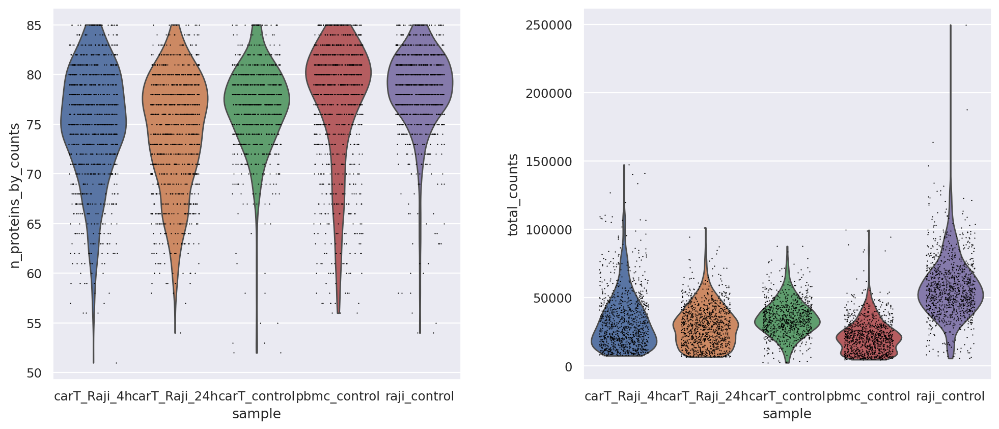

/tmp/ipykernel_304342/1196445922.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/pixelator/plot/__init__.py:271: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_data = data.groupby(color_by).size().reset_index(name="n")


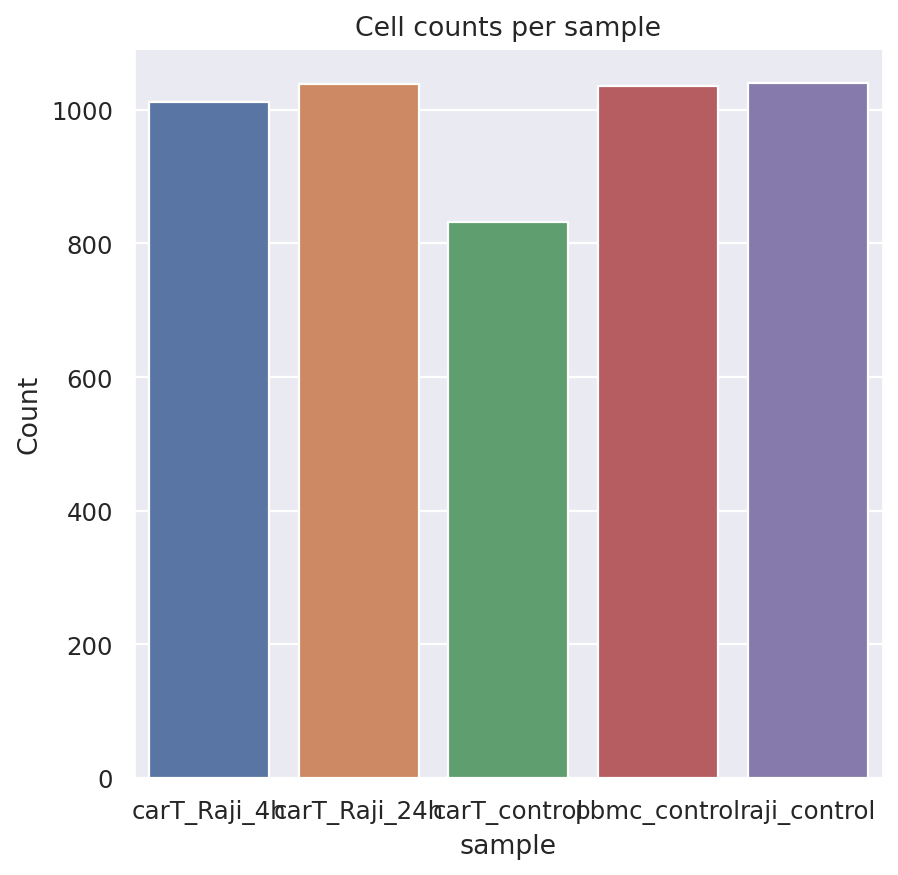

In [6]:
sc.pl.violin(
    adata,
    ["n_proteins_by_counts", "total_counts",],
    groupby='sample',
    jitter=0.3,
    multi_panel=True,
)
cells_per_sample_df = (
    adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
)

fig, ax = cell_count_plot(adata.obs, color_by="sample")

/tmp/ipykernel_304342/3572011806.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  molecule_rank_df["rank"] = molecule_rank_df.groupby(["sample"])["molecules"].rank(
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/pixelator/plot/__init__.py:133: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  edge_rank_df["rank"] = edge_rank_df.groupby([group_by])["molecules"].rank(


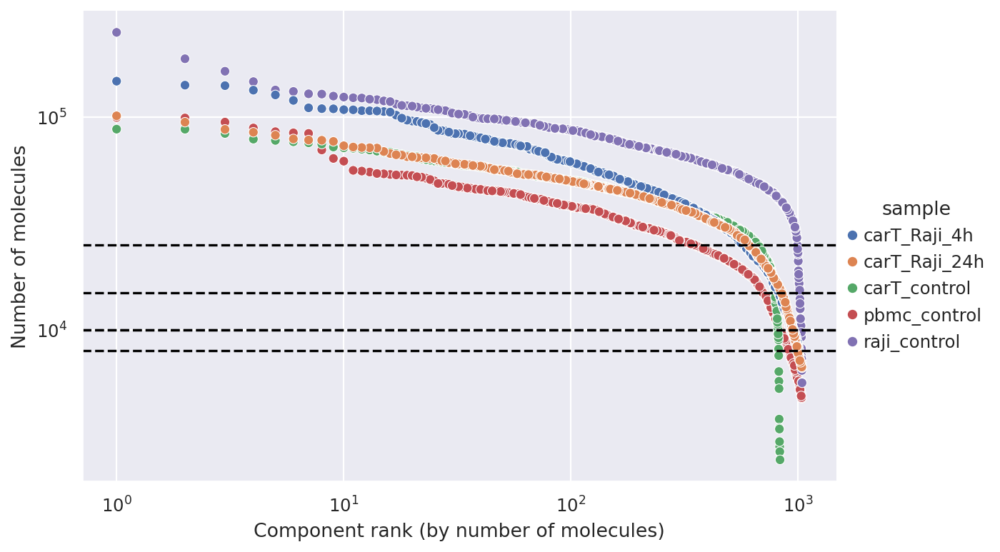

In [7]:
molecule_rank_df = adata.obs[["sample", "molecules"]].copy()
molecule_rank_df["rank"] = molecule_rank_df.groupby(["sample"])["molecules"].rank(
    ascending=False, method="first"
)
fig_intersection, ax = molecule_rank_plot(molecule_rank_df, group_by="sample")
molecule_thresh = {
    'carT_Raji_4h': 10000,
    'carT_Raji_24h': 10000,
    'carT_control': 15000,
    'pbmc_control': 8000,
    'raji_control': 25000,
}
for sample, thresh in molecule_thresh.items():
    ax.axhline(thresh, color='black', linestyle='--')

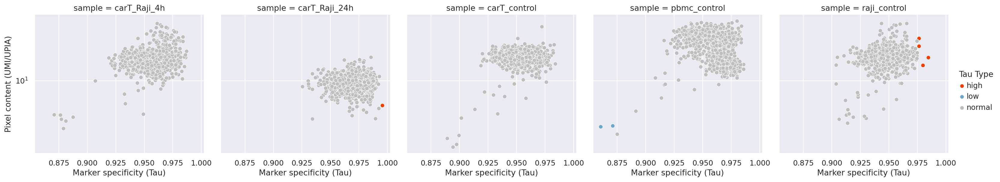

In [8]:
tau_metrics_df = adata.obs[["sample", "tau", "mean_molecules_per_a_pixel", "tau_type"]]
tau_metrics_df = tau_metrics_df.rename(columns={"mean_molecules_per_a_pixel": "umi_per_upia"})


fig, ax = scatter_umi_per_upia_vs_tau(tau_metrics_df, group_by="sample")

/tmp/ipykernel_304342/3061214977.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/pixelator/plot/__init__.py:271: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_data = data.groupby(color_by).size().reset_index(name="n")


4583


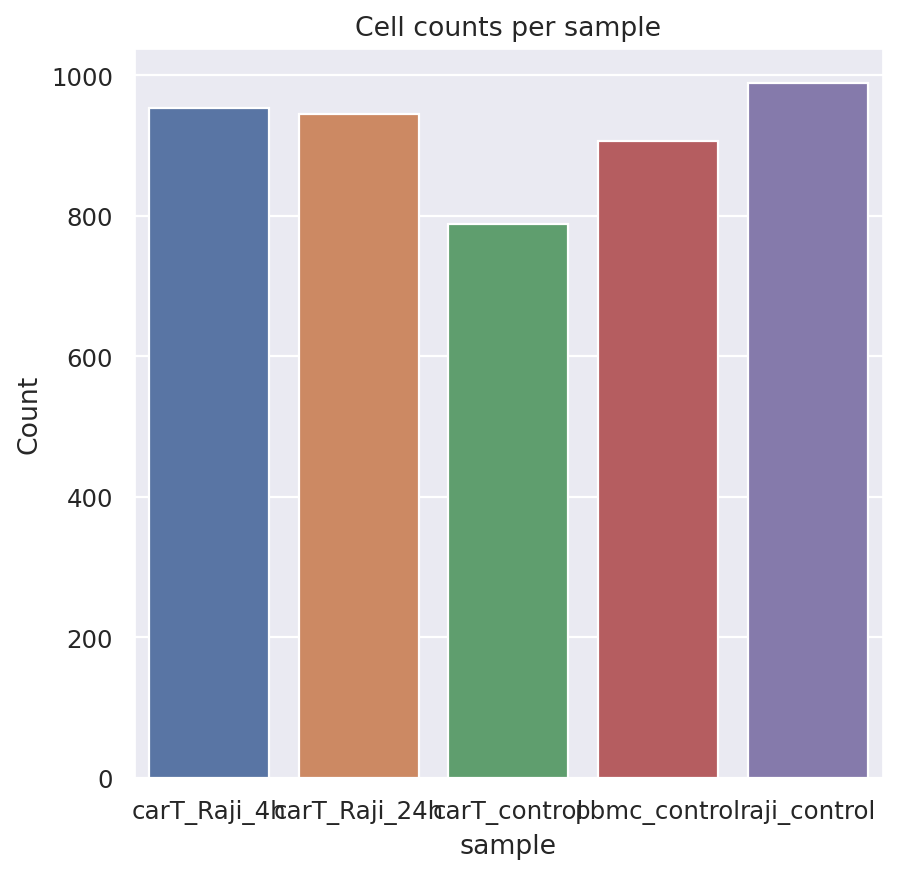

In [10]:
import functools

components = adata.obs[
    (adata.obs['tau_type'] == 'normal') & 
    functools.reduce(lambda x,y: x | y, [((adata.obs['sample'] == sample) & (adata.obs['molecules'] > thresh)) for sample, thresh in molecule_thresh.items()])
].index
orig_adata = adata.copy()
adata = orig_adata[components, :]
cells_per_sample_df = (
    adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
)

fig, ax = cell_count_plot(adata.obs, color_by="sample")
print(len(adata))

/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:207: Use

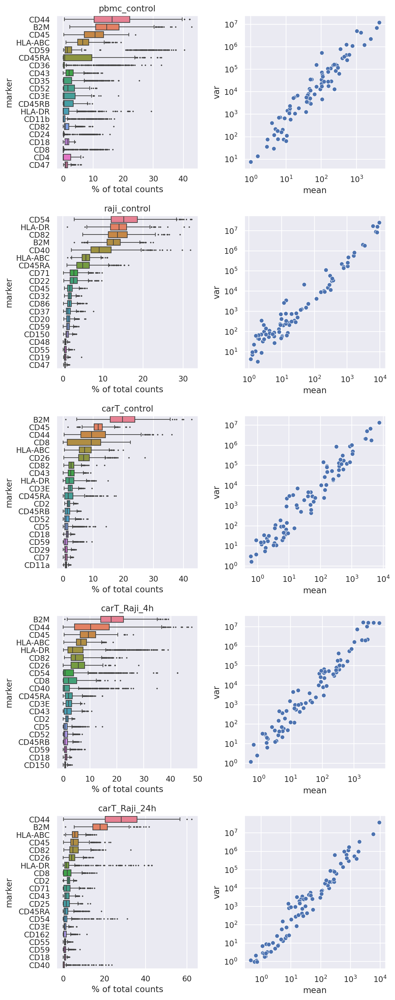

In [11]:
fig, axes = plt.subplots(len(SAMPLE_NAMES), 2, figsize=(8, 4*len(SAMPLE_NAMES)))
for i, sample in enumerate(SAMPLE_NAMES):
    sample_adata = adata[adata.obs['sample'] == sample]
    ax = sc.pl.highest_expr_genes(sample_adata, n_top=20, show=False, ax=axes[i][0])
    ax.set_title(sample)
    stats = sample_adata.to_df().agg(['mean', 'var',], axis=0).T
    sns.scatterplot(x=stats['mean'], y=stats['var'], ax=axes[i][1])
    axes[i][1].loglog()
fig.tight_layout()

In [5]:
isotype_controls=['mIgG1', 'mIgG2a', 'mIgG2b']
non_isotype_vars = [var for var in adata.var_names if var not in isotype_controls]

In [13]:
adata.layers['dsb'] = dsb_normalize(adata.to_df('counts'), isotype_controls=isotype_controls)
adata.layers['clr_by_cell'] = clr_transformation(adata.to_df('counts'), axis=1)
adata.layers['clr_by_ab'] = clr_transformation(adata.to_df('counts'), axis=0)
adata.layers['log1p'] = np.log1p(adata.to_df('counts'))

/tmp/ipykernel_304342/3382159607.py:1: ImplicitModificationWarning: Setting element `.layers['dsb']` of view, initializing view as actual.
  adata.layers['dsb'] = dsb_normalize(adata.to_df('counts'), isotype_controls=isotype_controls)


In [14]:
adata = adata[adata.obs['sample'] != 'pbmc_control', :]

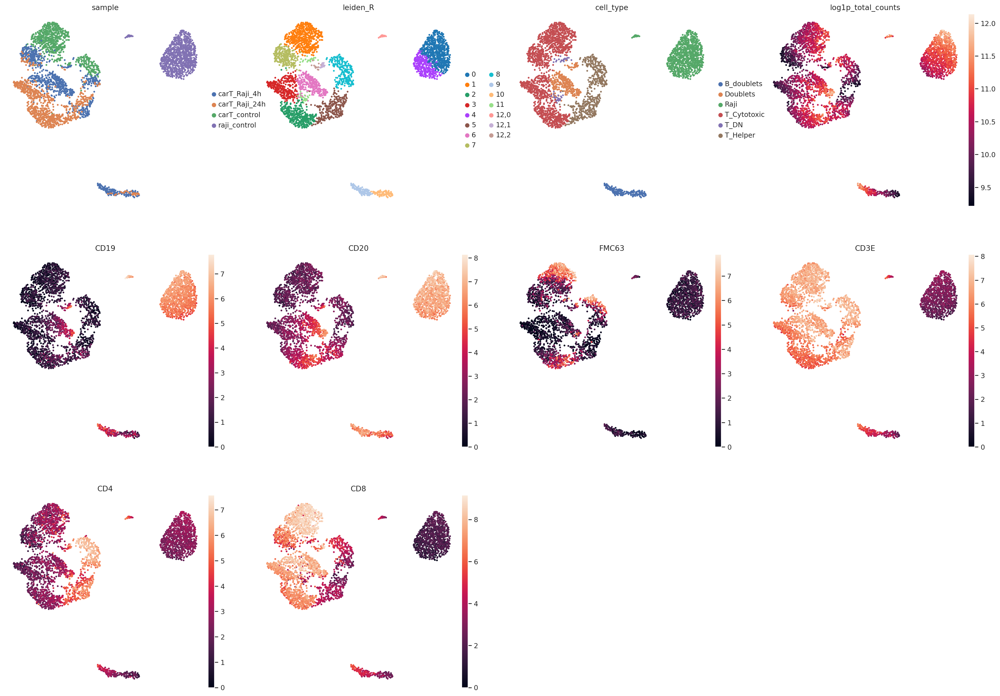

In [16]:
sc.pp.pca(adata, layer='log1p')
sc.pp.neighbors(adata,)
sc.tl.umap(adata, )
sc.tl.leiden(adata)


# Old - for dsb data

# sc.tl.leiden(adata, restrict_to=('leiden', ['4']), resolution=0.5)
# cell_type_dict = {
#     '0': 'T_Cytotoxic', '2': 'T_Cytotoxic', '6': 'T_Cytotoxic',
#     '8': 'T_Helper',
#     '4,1': 'CD19_CD3_CD4_Doublets', '4,4': 'CD19_CD3_CD4_Doublets', 
#     **{f'4,{i}': 'T_Helper' for i in [0,2,3]},
#     '1': 'Raji',
#     '3': 'Raji',
#     '7': 'Raji',
#     '9': 'CD19_CD3_CD8_Doublets',
#     '10': 'T_DN',
#     '11': 'CD19_CD3_Doublets',
#     '5': 'CD19_CD3_CD8_Doublets',
# }

# New - log1p data
# cell_type_dict = {
#     '2': 'Raji', '3': 'Raji', '4': 'Raji',
#     '9': 'CD19_CD3_CD8_Doublets', '7': 'CD19_CD3_CD8_Doublets',
#     '0': 'T_Cytotoxic', '1': 'T_Cytotoxic', '5': 'T_Cytotoxic',
#     '6': 'T_Helper', '8': 'T_Helper',
#     '10': 'T_DN',
#     '11,0': 'Raji', '11,1': 'CD19_CD3_CD8_Doublets',
# }

# adata.obs['cell_type'] = adata.obs['leiden_R'].map(cell_type_dict)
# sc.pl.umap(adata, layer='log1p', color=['sample', 'cell_type', 'leiden_R', 'CD19', 'FMC63', 'CD3E', 'CD4', 'CD8',])

sc.tl.leiden(adata, restrict_to=('leiden', ['12']), resolution=0.5)
cell_type_dict = {
    '0': 'Raji', '4': 'Raji', '12,0': 'Raji',
    '9': 'Doublets', '6': 'Doublets', '12,1': 'Doublets', '12,2': 'Doublets',
    '1': 'T_Cytotoxic', '2': 'T_Cytotoxic', '3': 'T_Cytotoxic', '7': 'T_Cytotoxic', 
    '5': 'T_Helper', '8': 'T_Helper',
    '11': 'T_DN', '9': 'B_doublets', '10': 'B_doublets'
}
adata.obs['cell_type'] = adata.obs['leiden_R'].map(cell_type_dict)
sc.pl.umap(adata, layer='log1p', color=['sample', 'leiden_R', 'cell_type', 'log1p_total_counts', 'CD19', 'CD20', 'FMC63', 'CD3E', 'CD4', 'CD8',])


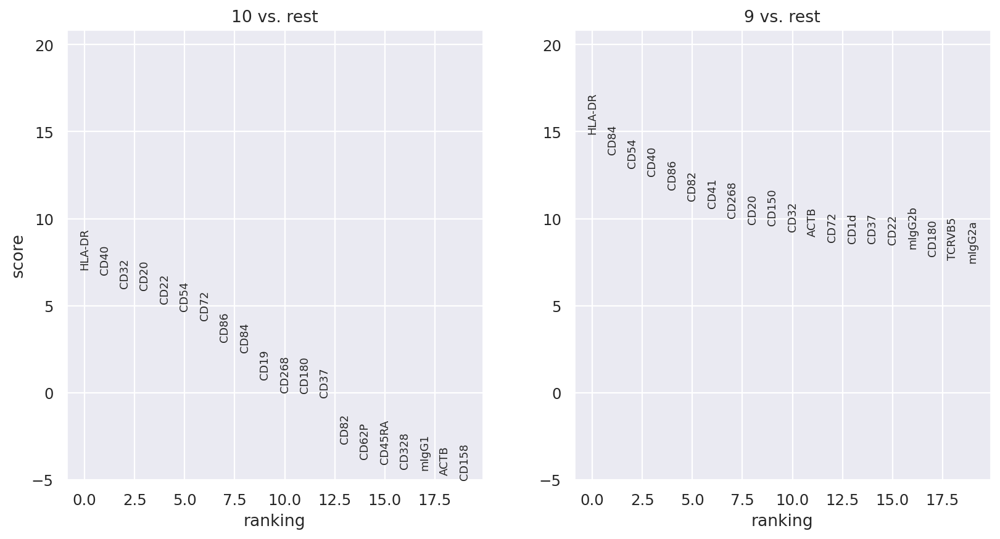

In [49]:
sc.tl.rank_genes_groups(adata, groupby='leiden_R', groups=['10', '9'], layer='log1p', use_raw=False, method='wilcoxon')
sc.pl.rank_genes_groups(adata)



# pd.set_option('display.max_rows', None)
# all_de = sc.get.rank_genes_groups_df(adata, group=None, pval_cutoff=0.05)
# pos_de = all_de[all_de['logfoldchanges'] > 0]
# neg_de = all_de[all_de['logfoldchanges'] < 0]

# for group in '9', '10':
#     print(pos_de[pos_de['group'] == group].sort_values(by='pvals', ascending=True).head(5))
#     print(neg_de[neg_de['group'] == group].sort_values(by='pvals', ascending=True).head(5))

# .sort_values(by='pvals', ascending=True).head(200)
# sc.pl.rank_genes_groups_dotplot(adata, n_genes=4, groups=['10', '9'], groupby='leiden_R', values_to_plot="logfoldchanges", vcenter=0, cmap='coolwarm')

In [83]:
adata.obs['cell_type'] = adata.obs['cell_type'].replace(
    {
        'Doublets': 'B-T',
     }
)

/tmp/ipykernel_1361064/907616988.py:1: FutureWarning:

The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.



In [5]:
# adata.write_h5ad(DATA_DIR / 'carT_hs_annotated_filtered.h5ad')
adata = anndata.read_h5ad(DATA_DIR / 'carT_hs_annotated_filtered.h5ad')

/tmp/ipykernel_2851156/346930510.py:1: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pol_hs_pivot = adata.uns['pol_hs'].pivot_table(index='component', columns='marker', values='pol_hs', fill_value=0).reindex(adata.obs.index)


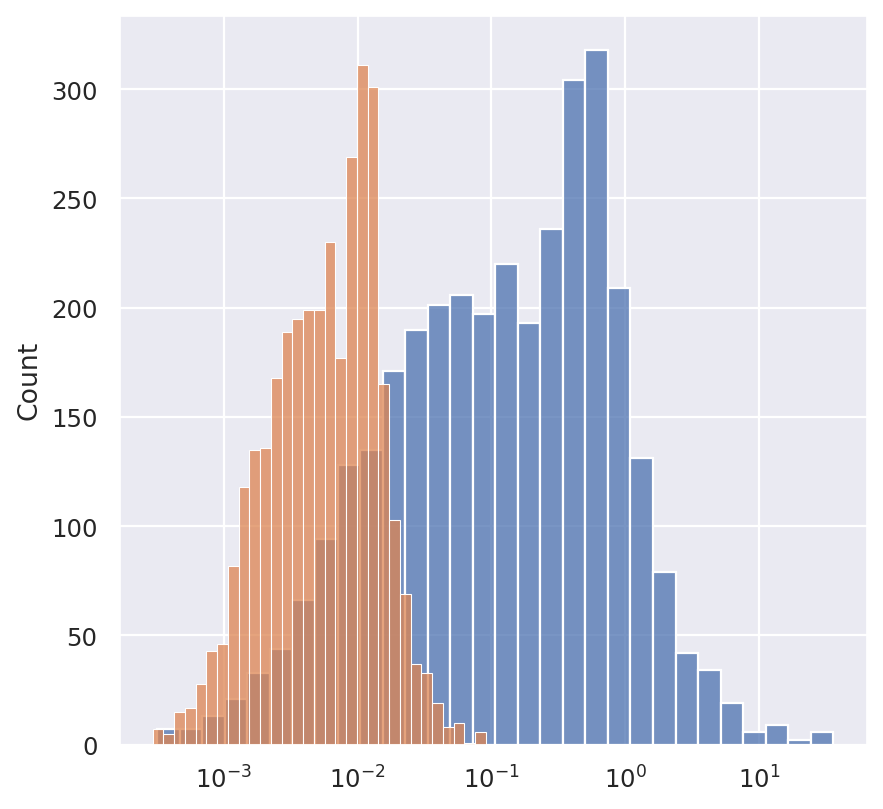

In [6]:
pol_hs_pivot = adata.uns['pol_hs'].pivot_table(index='component', columns='marker', values='pol_hs', fill_value=0).reindex(adata.obs.index)
coloc_hs_pivot = adata.uns['coloc_hs'].pivot_table(index='component', columns='pair_name', values='coloc_hs', fill_value=0).reindex(adata.obs.index)

# highly_varying = coloc_hs_pivot.std(axis=0).sort_values(ascending=False).index[:800]

coloc_second_moment = np.square(coloc_hs_pivot).sum(axis=0)
highly_varying = coloc_second_moment[coloc_second_moment > 1].index

adata.obsm['pol_hs'] = pol_hs_pivot
adata.obsm['coloc_hs'] = coloc_hs_pivot
adata.obsm['coloc_hs_hv'] = coloc_hs_pivot[highly_varying]

sns.histplot(np.square(coloc_hs_pivot).sum(axis=0), log_scale=True)
sns.histplot(coloc_hs_pivot.std(axis=0), log_scale=True)

def to_std(df):
    return (df - df.mean(axis=0)) / df.std(axis=0)

for key in ('pol_hs', 'coloc_hs', 'coloc_hs_hv'):
    adata.obsm[f'{key}_unit'] = (adata.obsm[key] + 1) / 2
    adata.obsm[f'{key}_std'] = to_std(adata.obsm[key])

adata.layers['log1p_std'] = to_std(adata.to_df('log1p'))

In [5]:
# adata.obs['CD44_pol_hs'] = pol_hs_pivot['CD44']

# pair = '(CD26,CD45)'
# adata.obs[pair] = coloc_hs_pivot[pair]

# ax = sns.histplot(adata.obs[adata.obs['sample'].isin(['raji_control', 'carT_Raji_4h', 'carT_Raji_24h'])], x=pair, hue='sample')
# ax.semilogy()

In [6]:
# pol, coloc = compute_hotspot_pol_and_coloc_single_component(
#     edgelist=pg_data.edgelist,
#     adata=adata,
#     components=adata.obs.index[0],
#     vars=non_isotype_vars,
#     marker_count_threshold=10, knn_neighbors=30
# )

In [7]:
# pol, coloc = compute_hotspot_pol_and_coloc(
#     edgelist=pg_data.edgelist,
#     adata=adata,
#     components=list(adata.obs.index),
#     vars=non_isotype_vars,
#     marker_count_threshold=10, knn_neighbors=30
# )
# adata.uns['pol_hs'] = pol
# adata.uns['coloc_hs'] = coloc
# adata.write_h5ad(DATA_DIR / 'carT_annotated_filtered.h5ad')

In [104]:
coloc = adata.uns['coloc_hs']

### Only Abundance

/home/projects/nyosef/eitangr/pixelgen/PixelGen/modules.py:398: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.unimodal_kl = unimodal_kl
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interv

Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 30 records. Best score: 97.785. Signaling Trainer to stop.


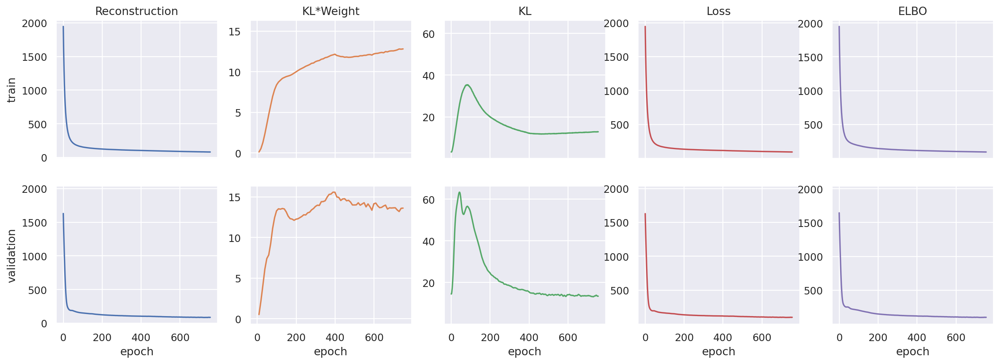

In [17]:
model_cls = MultiModalSCVI
setup_kwargs = dict(layer='log1p', batch_key=None, obsm_extra_modality_keys=[], n_modalities=1)
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, distrs=['normal',] , weights=None, agg_method='learned_global_avg',
                    unimodal_kl=True, joint_kl=True,
                    )

train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=30, batch_size=4000,
                    max_epochs=10000, enable_checkpointing=True, plan_kwargs=dict(lr=1e-3, optimizer='Adam', n_epochs_kl_warmup=400))

a_modalities_latent_names = [('joint', 'a_model_joint'), ('X', 'a_model_abundance'),]

abundance_model = train_model(adata, model_cls=model_cls, setup_kwargs=setup_kwargs, model_kwargs=model_kwargs, train_kwargs=train_kwargs, modalities_latent_names=a_modalities_latent_names)

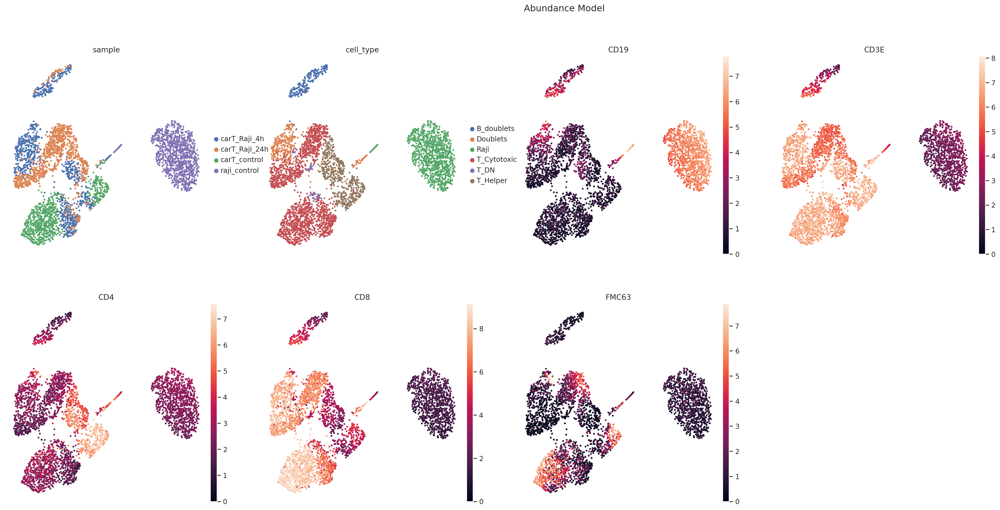

In [18]:
# umap_colors = ['sample', 'cell_type', 'CD44_pol', 'CD40_pol', 'CD45_pol',]

umap_colors = ['sample', 'cell_type', 'CD19', 'CD3E', 'CD4', 'CD8', 'FMC63']

# vcenter=0, cmap='RdBu_r', 
try:
    adata.obs.drop(columns=['CD19'], inplace=True)
except KeyError:
    pass

for c in umap_colors:
    if 'pol' in c:
        adata.obs[c] = adata.obsm['pol_hs'][c.split('_')[0]]

for modality, latent_name in a_modalities_latent_names[1:]:
    fig = pca_neighbors_umap(adata, latent_name, umap_pl_kwargs=dict(color=umap_colors, layer='log1p'), )
    weights = abundance_model.module.weights
    weights_str = np.array2string(weights, precision=2) if weights is not None else 'Per Point'
    if modality == 'joint':
        fig.suptitle(f'Multi Modal model, modality={modality}, weights={weights_str}')
    else:
        fig.suptitle(f'Abundance Model')
    fig.show()

### Abundance - Polarization

INFO     Using column names from columns of adata.obsm['pol_hs_unit']                                              


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'val_dataloader' d

Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 30 records. Best score: -87.172. Signaling Trainer to stop.


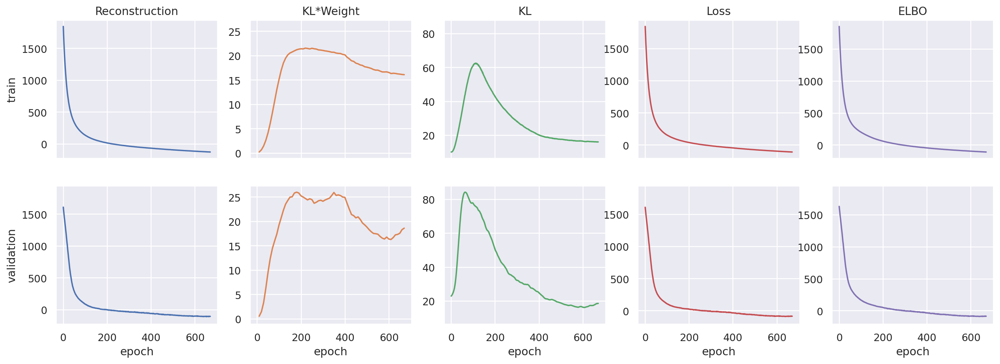

In [18]:
model_cls = MultiModalSCVI
setup_kwargs = dict(layer='log1p', batch_key=None, obsm_extra_modality_keys=['pol_hs_unit'], n_modalities=2)
model_kwargs = dict(n_latent=25, n_hidden=128, n_layers=1, dropout_rate=0.1, distrs=['normal', 'beta',], weights=None, agg_method='learned_global_avg',
                    unimodal_kl=True, joint_kl=True, loss_weights='auto',
                    )

train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=30, batch_size=4000,
                    max_epochs=10000, enable_checkpointing=True, plan_kwargs=dict(lr=5e-4, optimizer='Adam', n_epochs_kl_warmup=400))

ap_modalities_latent_names = [('joint', 'ap_model_joint'), ('X', 'ap_model_abundance'), ('pol_hs_unit', 'ap_model_pol'),]

abundance_pol_model = train_model(adata, model_cls=model_cls, setup_kwargs=setup_kwargs, model_kwargs=model_kwargs, train_kwargs=train_kwargs, modalities_latent_names=ap_modalities_latent_names)

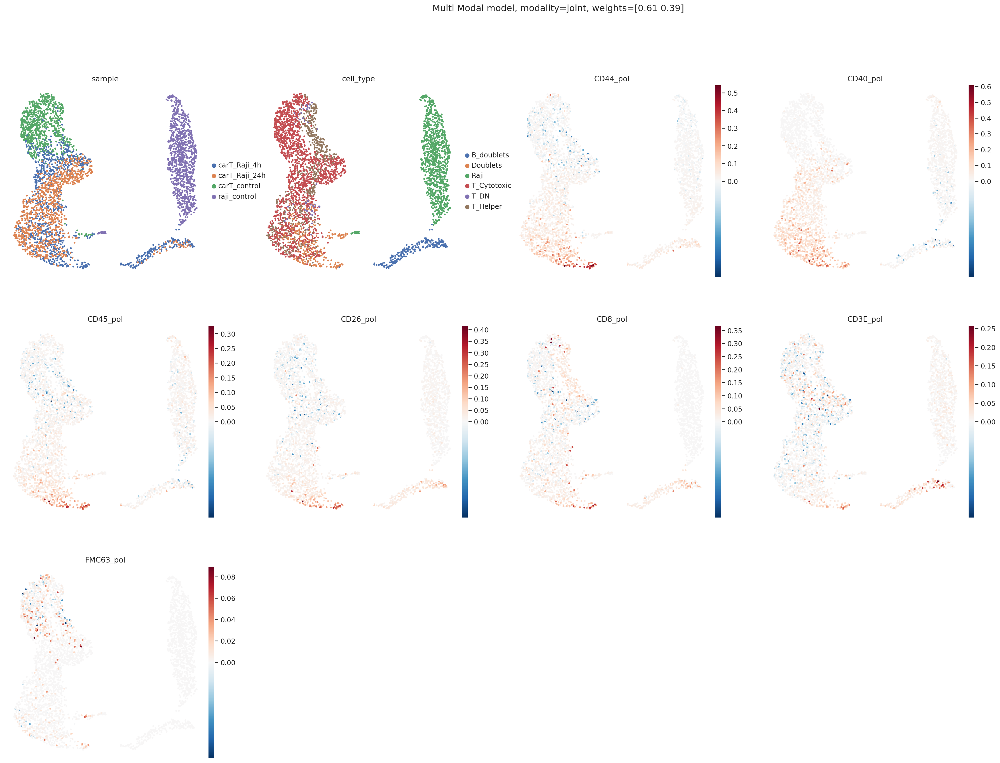

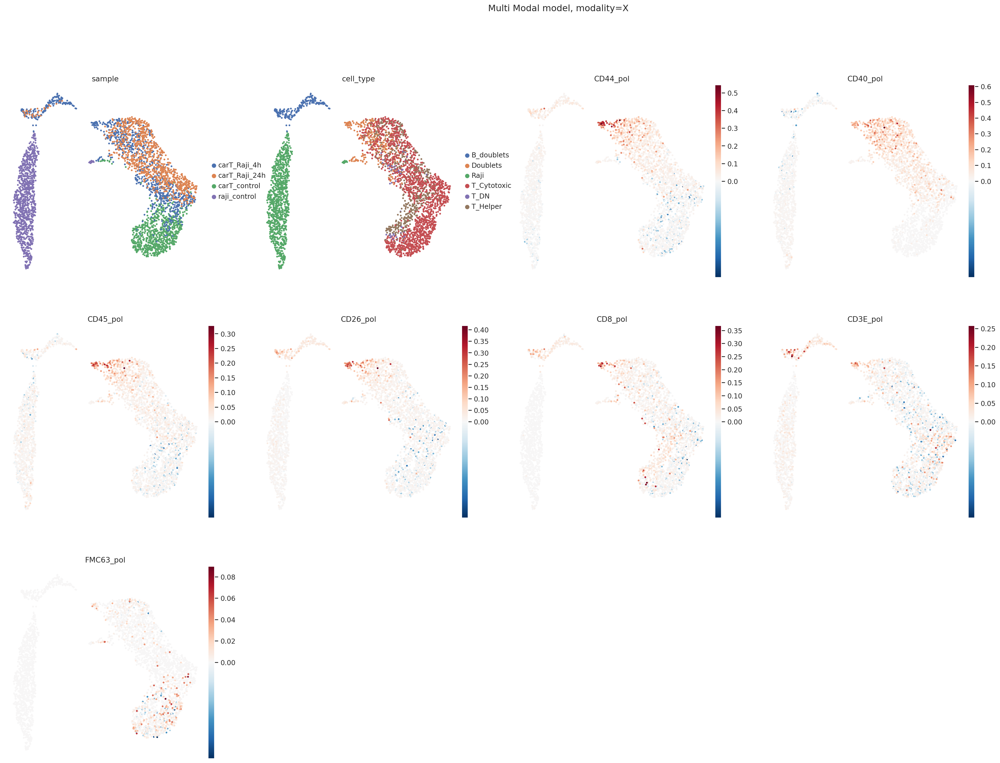

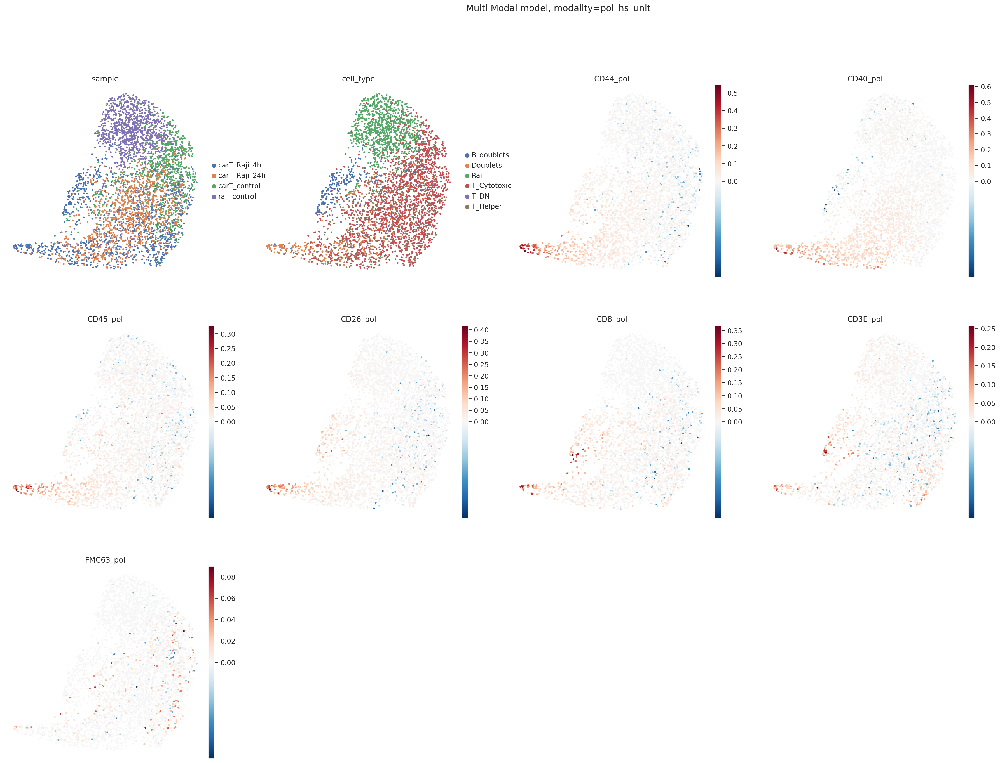

In [19]:
umap_colors = ['sample', 'cell_type', 'CD44_pol', 'CD40_pol', 'CD45_pol', 'CD26_pol', 'CD8_pol', 'CD3E_pol', 'FMC63_pol']

for c in umap_colors:
    if 'pol' in c:
        adata.obs[c] = adata.obsm['pol_hs'][c.split('_')[0]]

for modality, latent_name in ap_modalities_latent_names:
    fig = pca_neighbors_umap(adata, latent_name, umap_pl_kwargs=dict(color=umap_colors, vcenter=0, cmap='RdBu_r', layer='log1p'), )
    weights = abundance_pol_model.module.weights
    weights_str = np.array2string(weights, precision=2) if weights is not None else 'Per Point'
    if modality == 'joint':
        fig.suptitle(f'Multi Modal model, modality={modality}, weights={weights_str}')
    else:
        fig.suptitle(f'Multi Modal model, modality={modality}')
    fig.show()

In [28]:
ap_autocorr = distr_autocorrelation_in_latent(adata, 
                latent_neighbors_connectivities_key_lst=['ap_model_joint_connectivities', 'ap_model_pol_connectivities'], 
                names=['ap_joint_latent', 'ap_pol_latent'], distr_key='pol_hs_unit')
ap_autocorr.sort_values(by='morans', ascending=False).head(50)

,morans,gearys,latent
CD44,0.841798,0.121978,ap_pol_latent
CD54,0.802307,0.129473,ap_pol_latent
HLA-DR,0.794102,0.161214,ap_pol_latent
CD40,0.764024,0.158575,ap_pol_latent
CD26,0.736429,0.204329,ap_pol_latent
CD45,0.720509,0.194531,ap_pol_latent
CD44,0.680769,0.260454,ap_joint_latent
CD45,0.622441,0.319848,ap_joint_latent
CD40,0.619022,0.322527,ap_joint_latent
CD54,0.616005,0.346948,ap_joint_latent


### Abundance - Polarization - Colocalization

INFO     Using column names from columns of adata.obsm['pol_hs_unit']                                              
INFO     Using column names from columns of adata.obsm['coloc_hs_unit']                                            


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'val_dataloader' d

Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 50 records. Best score: -38.987. Signaling Trainer to stop.


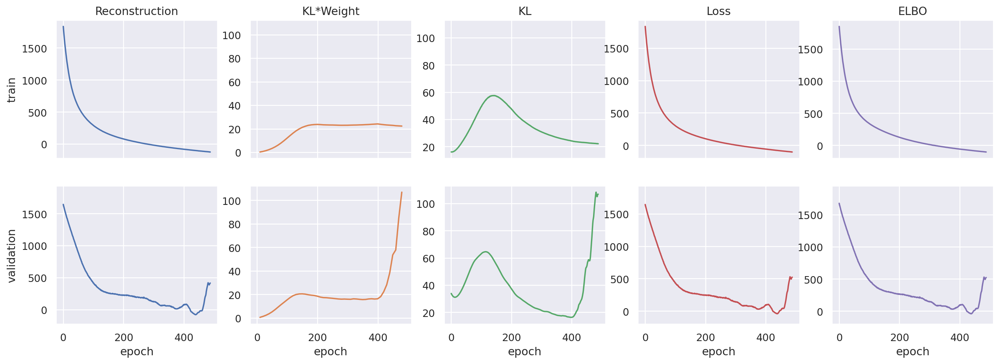

In [ ]:
model_cls = MultiModalSCVI
setup_kwargs = dict(layer='log1p', batch_key=None, obsm_extra_modality_keys=['pol_hs_unit', 'coloc_hs_hv_unit'], n_modalities=3)
model_kwargs = dict(n_latent=30, n_hidden=128, n_layers=1, dropout_rate=0.1, distrs=['normal', 'beta', 'beta'], weights=None, agg_method='learned_global_avg',
                    unimodal_kl=True, joint_kl=True, loss_weights='auto', dispersion=''
                    )

train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=50, batch_size=4000,
                    max_epochs=10000, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=400))

apc_modalities_latent_names = [('joint', 'apc_model_joint'), ('X', 'apc_model_abundance'), ('pol_hs_unit', 'apc_model_pol'), ('coloc_hs_unit', 'apc_model_coloc')]

apc_model = train_model(adata, model_cls=model_cls, setup_kwargs=setup_kwargs, model_kwargs=model_kwargs, train_kwargs=train_kwargs, modalities_latent_names=apc_modalities_latent_names)

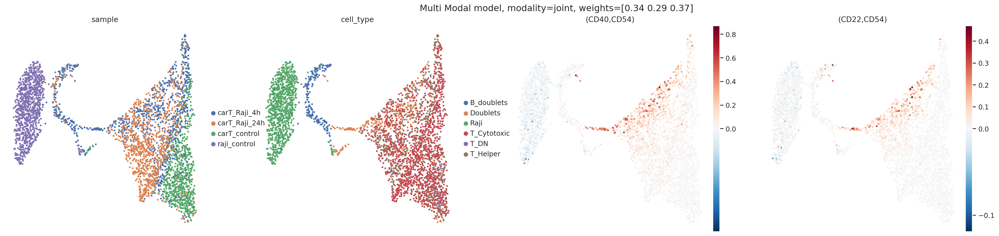

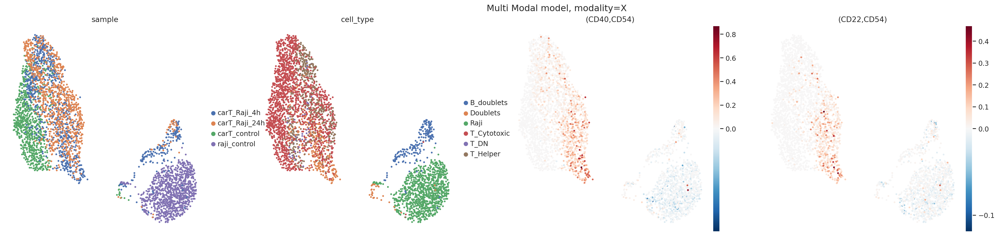

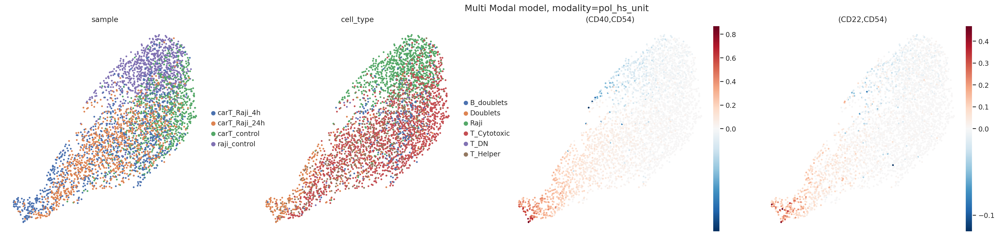

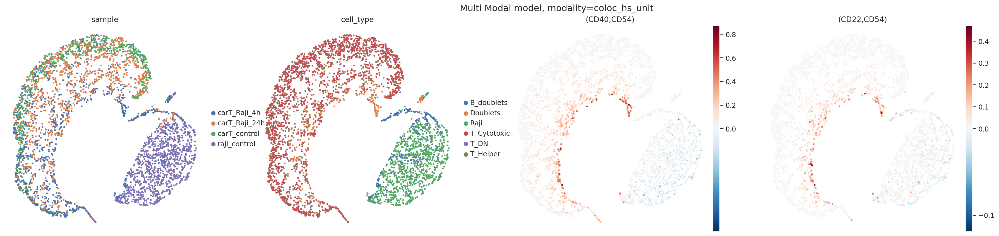

In [23]:
umap_colors = ['sample', 'cell_type', '(CD40,CD54)', '(CD22,CD54)', ]

for c in umap_colors:
    if '(' in c:
        adata.obs[c] = adata.obsm['coloc_hs'][c]

for modality, latent_name in apc_modalities_latent_names:
    fig = pca_neighbors_umap(adata, latent_name, umap_pl_kwargs=dict(color=umap_colors, vcenter=0, cmap='RdBu_r', layer='log1p'), )
    weights = apc_model.module.weights
    weights_str = np.array2string(weights, precision=2) if weights is not None else 'Per Point'
    if modality == 'joint':
        fig.suptitle(f'Multi Modal model, modality={modality}, weights={weights_str}')
    else:
        fig.suptitle(f'Multi Modal model, modality={modality}')
    fig.show()

### Abundance - Polarization - Colocalization: Shared Encoder

In [ ]:
scvi.model.SCVI

INFO     Using column names from columns of adata.obsm['pol_hs_std']                                               
INFO     Using column names from columns of adata.obsm['coloc_hs_hv_std']                                          


/home/projects/nyosef/eitangr/pixelgen/PixelGen/modules.py:372: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self._loss_weights = torch.tensor(loss_weights, requires_grad=False)
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.
/home/projects/nyosef/eitangr/miniconda3/envs/pixelgen-scvi/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches 

Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 30 records. Best score: 309.891. Signaling Trainer to stop.


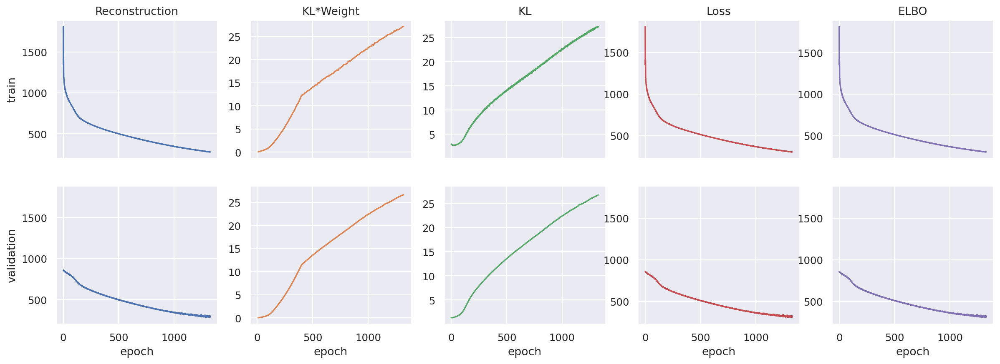

In [ ]:
model_cls = MultiModalSCVI
setup_kwargs = dict(layer='log1p_std', batch_key=None, obsm_extra_modality_keys=['pol_hs_unit', 'coloc_hs_hv_unit'], n_modalities=3)
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, distrs=['normal', 'beta', 'beta'], weights=None, 
                    agg_method='shared_encoder',
                    unimodal_kl=False, joint_kl=True, loss_weights='auto,
                    )

train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=30, batch_size=4000,
                    max_epochs=10000, enable_checkpointing=True, plan_kwargs=dict(lr=1e-4, optimizer='Adam', n_epochs_kl_warmup=400))

shared_apc_modalities_latent_names = [('joint', 'shared_apc_model_joint'), ]

shared_apc_model = train_model(adata, model_cls=model_cls, setup_kwargs=setup_kwargs, model_kwargs=model_kwargs, train_kwargs=train_kwargs, 
                               modalities_latent_names=shared_apc_modalities_latent_names)

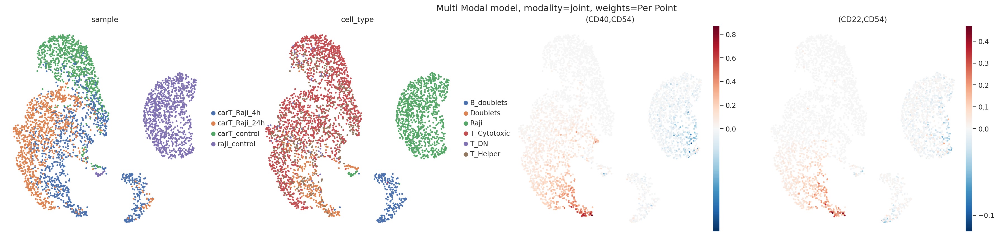

In [47]:
umap_colors = ['sample', 'cell_type', '(CD40,CD54)', '(CD22,CD54)', ]

for c in umap_colors:
    if '(' in c:
        adata.obs[c] = adata.obsm['coloc_hs'][c]

for modality, latent_name in shared_apc_modalities_latent_names:
    fig = pca_neighbors_umap(adata, latent_name, umap_pl_kwargs=dict(color=umap_colors, vcenter=0, cmap='RdBu_r', layer='log1p'), )
    weights = shared_apc_model.module.weights
    weights_str = np.array2string(weights, precision=2) if weights is not None else 'Per Point'
    if modality == 'joint':
        fig.suptitle(f'Multi Modal model, modality={modality}, weights={weights_str}')
    else:
        fig.suptitle(f'Multi Modal model, modality={modality}')
    fig.show()

In [67]:
adata.obs['coloc_group'].where(
            (adata.obs['coloc_group'] != 'T_diff') | (adata.obs['cell_type'] != 'Doublets'),
            'T_diff_doublets'
            )

component
00b9b94431e239dd_raji_control                   B
00c036ac29fd5710_raji_control                   B
00da4a514d9c21d3_raji_control                   B
010cf5b775e0cf7e_raji_control                   B
0182bd29ef26f448_raji_control                   B
019723fb1ec90c40_raji_control                   B
02aac5f3e36ddc64_raji_control                   B
033d0cfd2339f73d_raji_control                   B
03ae9fc6633dc367_raji_control                   B
03ee28e148af3dbf_raji_control                   B
04a646d6f0666818_raji_control                   B
04e599e0453c400c_raji_control                   B
05a7a866853dc3e2_raji_control                   B
062f2728b443cde1_raji_control                   B
0653852c9165a289_raji_control                   B
0674cc5feb4654df_raji_control                   B
067b0369b58c8646_raji_control                   B
06a5d033a87acd1f_raji_control                   B
07208d06be37f4c5_raji_control                   B
07259a06c576f625_raji_control           

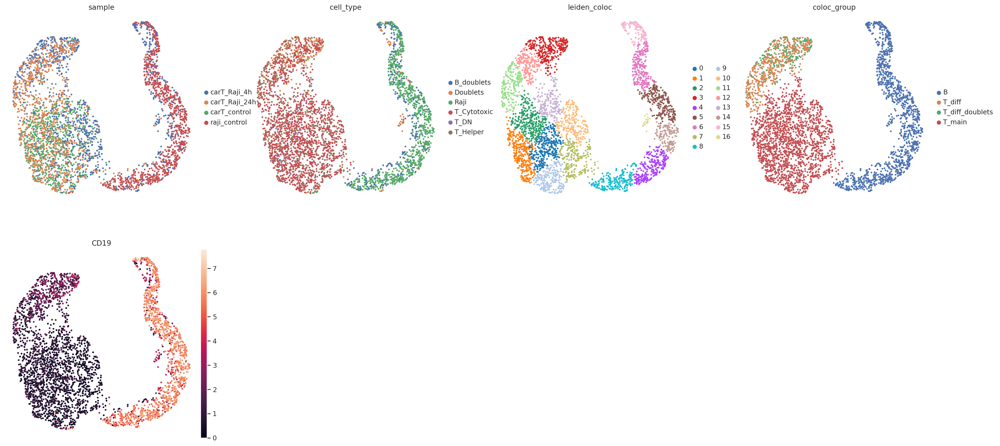

In [78]:
sc.tl.leiden(adata, key_added='leiden_coloc', neighbors_key='apc_model_coloc')
sc.tl.umap(adata, neighbors_key='apc_model_coloc')

pol_df = adata.obsm['pol_hs_unit'].copy()
# pol_df.columns = [f'{c}_pol' for c in pol_df.columns]

coloc_df = adata.obsm['coloc_hs_unit']

combined_adata = anndata.AnnData(
    X=pd.concat(
        (adata.to_df('log1p'), pol_df, coloc_df),
        axis=1
    ),
    obs=adata.obs,
    obsm=adata.obsm
)

combined_adata.obs['coloc_group'] = combined_adata.obs['leiden_coloc'].map(
    {
        '3': 'T_diff', '11': 'T_diff', '12': 'T_diff',
        '0': 'T_main', '1': 'T_main', '2': 'T_main', '9': 'T_main', '10': 'T_main', '13': 'T_main', '7': 'T_main',
        '4': 'B', '5': 'B', '6': 'B', '8': 'B', '14': 'B', '15': 'B', '16': 'B',
    }
)

combined_adata.obs['coloc_group'] = combined_adata.obs['coloc_group'].where(
            (combined_adata.obs['coloc_group'] != 'T_diff') | (combined_adata.obs['cell_type'] != 'Doublets'),
            'T_diff_doublets'
            )

sc.pl.umap(combined_adata, color=['sample', 'cell_type', 'leiden_coloc', 'coloc_group', 'CD19'])


In [72]:
adata.obs['coloc_group'].value_counts()

coloc_group
T_main             1756
B                  1245
T_diff              447
T_diff_doublets     229
Name: count, dtype: int64

<Axes: xlabel='CD19', ylabel='Count'>

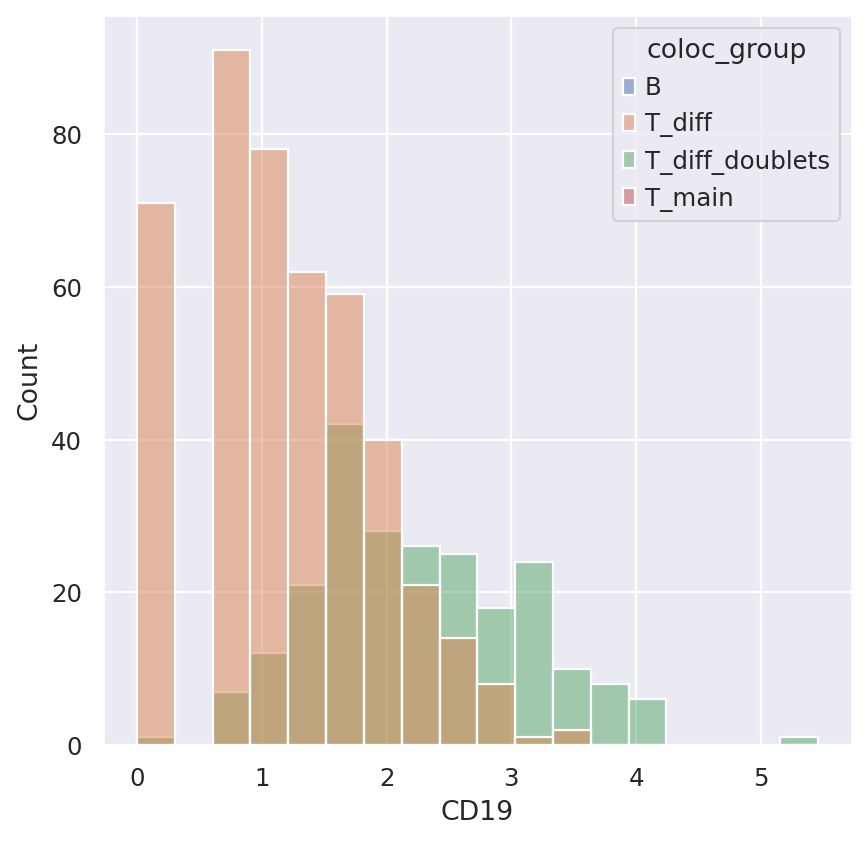

In [83]:
combined_adata.obs['CD19'] = combined_adata.to_df()['CD19']
sns.histplot(combined_adata.obs[combined_adata.obs['coloc_group'].isin(['T_diff', 'T_diff_doublets',])], x='CD19', hue='coloc_group')

In [ ]:
sc.tl.rank_genes_groups(combined_adata, groupby='coloc_group', groups=['T_diff', 'T_diff_doublets'], reference='T_main', method='wilcoxon')
de_df = sc.get.rank_genes_groups_df(combined_adata, group='T_diff', pval_cutoff=0.05)
pd.set_option('display.max_rows', None)
de_df.sort_values(by='pvals', ascending=True).head(100)

,names,scores,logfoldchanges,pvals,pvals_adj
0,CD22,31.505322,3.242139,7.344578e-218,2.561789e-214
1,CD40,30.752712,5.198233,1.124811e-207,1.961670e-204
2,CD20,30.223059,2.681435,1.179238e-200,1.371060e-197
3,"(CD40,HLA-DR)",29.412067,0.221082,3.849511e-190,3.356774e-187
4,"(CD22,CD37)",29.377420,0.046330,1.067125e-189,7.444267e-187
5,CD32,29.023624,2.213008,3.312668e-185,1.925764e-182
6,CD22_pol,28.886911,0.040060,1.743430e-183,8.687264e-181
7,"(CD22,HLA-DR)",28.872004,0.091204,2.682923e-183,1.169755e-180
8,"(CD22,CD40)",28.795424,0.100052,2.447540e-182,9.485579e-180
1206,"(CD40,CD44)",-28.745285,-0.186858,1.037402e-181,3.618458e-179


: 

In [84]:
apc_autocorr = distr_autocorrelation_in_latent(adata, 
                # latent_neighbors_connectivities_key_lst=['apc_model_joint_connectivities', 'apc_model_pol_connectivities', 'apc_model_coloc_connectivities'], names=['ap_joint_latent', 'ap_pol_latent', 'ap_coloc_latent'],
                latent_neighbors_connectivities_key_lst=['apc_model_joint_connectivities',], names=['apc_joint_latent', ], 
                distr_key='coloc_hs_unit')
apc_autocorr.sort_values(by='morans', ascending=False).head(50)

,morans,gearys,latent
"(CD44,CD45)",0.832247,0.124578,apc_joint_latent
"(CD26,CD54)",0.819844,0.133662,apc_joint_latent
"(CD40,CD45)",0.819487,0.134509,apc_joint_latent
"(CD45,HLA-DR)",0.817390,0.130508,apc_joint_latent
"(CD2,CD44)",0.813957,0.134992,apc_joint_latent
"(CD44,CD54)",0.810439,0.139510,apc_joint_latent
"(CD26,CD45)",0.809094,0.142622,apc_joint_latent
"(CD2,CD45)",0.807095,0.146169,apc_joint_latent
"(CD2,CD54)",0.801184,0.141753,apc_joint_latent
"(CD26,CD44)",0.799990,0.148904,apc_joint_latent


In [8]:
import logging
import time

logging_kwargs = dict(level=logging.INFO, format="%(asctime)s - %(message)s")
logging.basicConfig(**logging_kwargs)
logger = logging.getLogger()    
logger.setLevel(logging.INFO)
logging.info('hi')
time.sleep(2)
print('hello')

2025-04-22 12:39:08,875 - hi


hello


In [ ]:
edgelist = pg_data.edgelist
_ = edgelist[edgelist['component'] == edgelist['component'].iloc[0]]

In [47]:
pol, coloc = compute_hotspot_pol_and_coloc(
    edgelist=pg_data.edgelist, 
    adata=adata, 
    components=adata.obs.index[:2], 
    vars=non_isotype_vars, 
    marker_count_threshold=10, 
    knn_neighbors=30, 
    njobs=1,
)

Beginning conversion...
Calc 0
Calc 1
Finished conversion!


In [19]:
import polars as pl

lf = pg_data.edgelist_lazy
component_edgelist = lf.filter(pl.col("component") == '7b95e6d237a1e427_carT_Raji_4h').collect()

In [21]:
component_edgelist = component_edgelist.to_pandas()

In [20]:
import networkx as nx

In [26]:
results = get_pixel_nbhd_counts(component_edgelist, adata, pixel_type='a', nbhd_radius=2, compute_pixel_graph=True, components=[component])
g = results['graphs'][0]

[24/04/25 10:58:29]: Starting conversion...


100%|██████████| 1/1 [00:00<00:00,  3.84it/s]


In [57]:
[v for v in adata.var_names if 'CD28' in v]

[]

In [90]:
pixel_counts_pivot = results['pixel_counts'].pivot_table(index='upi_int', columns='marker', values='Count', observed=True, fill_value=0)
m1 = 'CD54'
m2 = 'CD44'
is_raji = (pixel_counts_pivot['CD19'] > 0) | (pixel_counts_pivot['CD20'] > 0) | (pixel_counts_pivot['CD40'] > 0) | (pixel_counts_pivot['CD22'] > 0) | (pixel_counts_pivot['CD32'] > 0) | (pixel_counts_pivot['CD54'] > 0)
is_carT = (pixel_counts_pivot['CD3E'] > 0) | (pixel_counts_pivot['CD8'] > 0) | (pixel_counts_pivot['FMC63'] > 0) | (pixel_counts_pivot['CD4'] > 0) | (pixel_counts_pivot['CD25'] > 0) | (pixel_counts_pivot['CD45RA'] > 0) | (pixel_counts_pivot['CD44'] > 0)
color = [
    {
        (True, True): 'darkmagenta',
        (True, False): 'firebrick',
        (False, True): 'royalblue',
        (False, False): 'gray',
    }[(r,c)] for r,c in zip(is_raji, is_carT)
]

In [32]:
nxG = nx.from_scipy_sparse_array(g.W, edge_attribute='weight')
pos = nx.spring_layout(nxG)

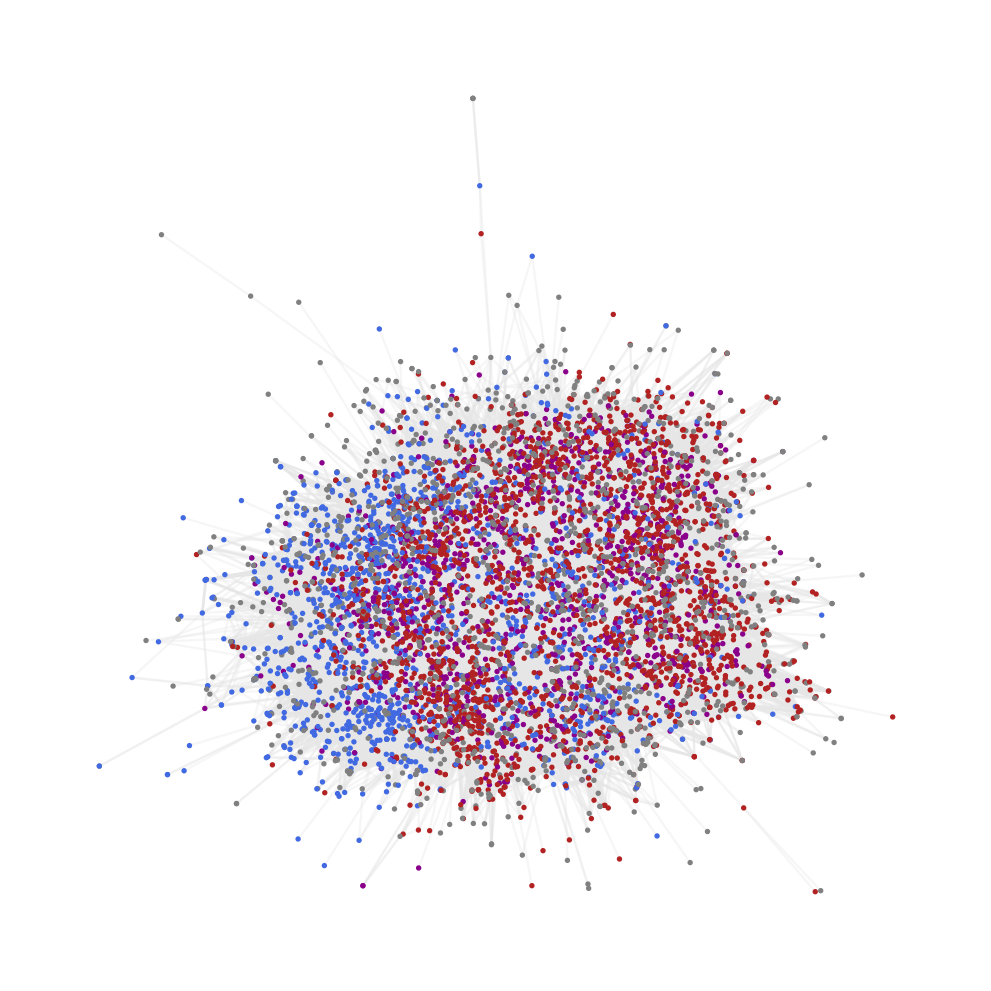

In [91]:
nx.draw(nxG, pos=pos, node_size=2, edge_color=(0.9, 0.9, 0.9, 0.35), node_color=color)         # computes spring_layout by default
plt.show()

In [76]:
adata.obs['CD19'] = adata.to_df()['CD19']
adata.obs[adata.obs['cell_type'] == 'Doublets'].sort_values(by='CD19', ascending=False)
component = '7b95e6d237a1e427_carT_Raji_4h'

gld = compute_graph_layout(pg_data, component)
plot_cell_with_markers(gld, marker_1='CD19', marker_2='CD44')